In [1]:
import functools
import os

from matplotlib import gridspec
import matplotlib.pylab as plt
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub

print("TF Version: ", tf.__version__)
print("TF Hub version: ", hub.__version__)
print("Eager mode enabled: ", tf.executing_eagerly())
print("GPU available: ", tf.config.list_physical_devices('GPU'))

TF Version:  2.10.0
TF Hub version:  0.12.0
Eager mode enabled:  True
GPU available:  [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [65]:
# @title Define image loading and visualization functions  { display-mode: "form" }

def crop_center(image):
  """Returns a cropped square image."""
  shape = image.shape
  new_shape = min(shape[1], shape[2])
  offset_y = max(shape[1] - shape[2], 0) // 2
  offset_x = max(shape[2] - shape[1], 0) // 2
  image = tf.image.crop_to_bounding_box(
      image, offset_y, offset_x, new_shape, new_shape)
  return image

@functools.lru_cache(maxsize=None)
def load_image(image_url, image_size=(256, 256), preserve_aspect_ratio=True):
  """Loads and preprocesses images."""
  # Cache image file locally.
  image_path = tf.keras.utils.get_file(os.path.basename(image_url)[-128:], image_url)
  # Load and convert to float32 numpy array, add batch dimension, and normalize to range [0, 1].
  img = tf.io.decode_image(
      tf.io.read_file(image_path),
      channels=3, dtype=tf.float32)[tf.newaxis, ...]
  img = crop_center(img)
  img = tf.image.resize(img, image_size, preserve_aspect_ratio=True)
  return img

def show_n(images, titles=('',)):
  n = len(images)
  image_sizes = [image.shape[1] for image in images]
  w = (image_sizes[0] * 6) // 320
  plt.figure(figsize=(w * n, w))
  gs = gridspec.GridSpec(1, n, width_ratios=image_sizes)
  for i in range(n):
    plt.subplot(gs[i])
    plt.imshow(images[i][0], aspect='equal')
    plt.axis('off')
    plt.title(titles[i] if len(titles) > i else '')
  plt.show()

2684586/2684586 [==============================] - 1s 0us/step


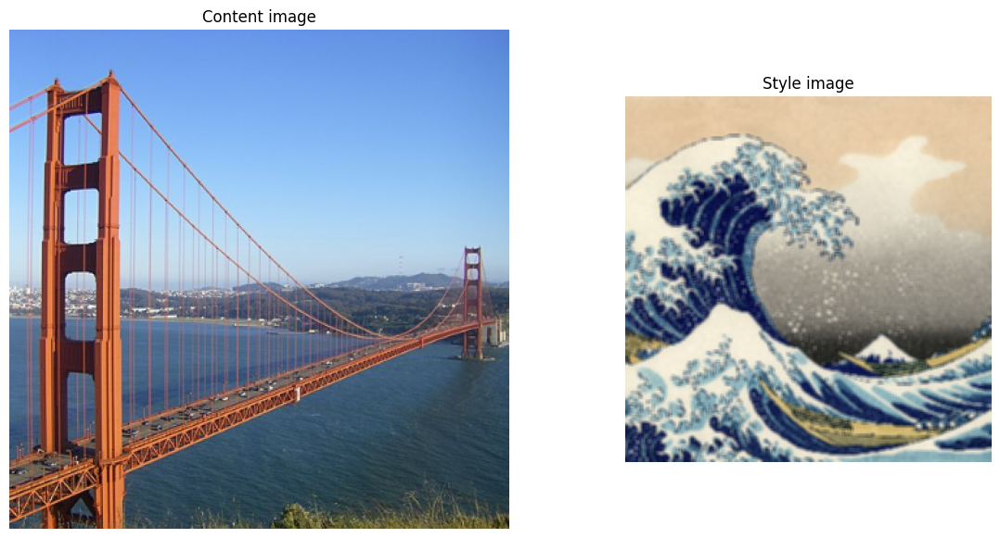

In [3]:
# @title Load example images  { display-mode: "form" }

content_image_url = 'https://upload.wikimedia.org/wikipedia/commons/thumb/f/fd/Golden_Gate_Bridge_from_Battery_Spencer.jpg/640px-Golden_Gate_Bridge_from_Battery_Spencer.jpg'  # @param {type:"string"}
style_image_url = 'https://upload.wikimedia.org/wikipedia/commons/0/0a/The_Great_Wave_off_Kanagawa.jpg'  # @param {type:"string"}
output_image_size = 384  # @param {type:"integer"}

# The content image size can be arbitrary.
content_img_size = (output_image_size, output_image_size)
# The style prediction model was trained with image size 256 and it's the 
# recommended image size for the style image (though, other sizes work as 
# well but will lead to different results).
style_img_size = (256, 256)  # Recommended to keep it at 256.

content_image = load_image(content_image_url, content_img_size)
style_image = load_image(style_image_url, style_img_size)
style_image = tf.nn.avg_pool(style_image, ksize=[3,3], strides=[1,1], padding='SAME')
show_n([content_image, style_image], ['Content image', 'Style image'])

In [4]:
# Load TF Hub module.

hub_handle = 'https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2'
hub_module = hub.load(hub_handle)

In [6]:
# Stylize content image with given style image.
# This is pretty fast within a few milliseconds on a GPU.

outputs = hub_module(tf.constant(content_image), tf.constant(style_image))
stylized_image = outputs[0]

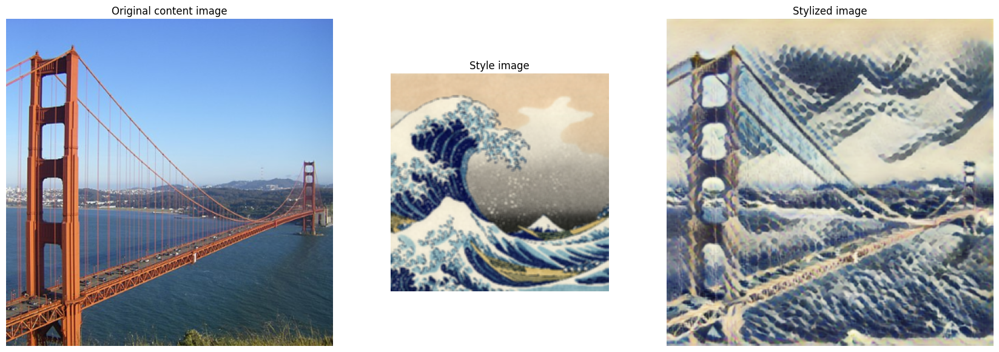

In [7]:
# Visualize input images and the generated stylized image.

show_n([content_image, style_image, stylized_image], titles=['Original content image', 'Style image', 'Stylized image'])

In [13]:
from PIL import Image

In [255]:
corbeau = Image.open('corbeau_night.jpg')

In [247]:
chief_hen_1 = Image.open('chief_henry_1.JPG')
chief_hen_2 = Image.open('chief_henry_2.JPG')

In [186]:
mom_jazzy = Image.open('mom_jazzy.jpg')
print(mom_jazzy.size)

(3024, 4032)


In [266]:
burke_funny = Image.open('burke_funny.jpg')
print(burke_funny.size)

(1080, 1920)


In [256]:
corbeau.size

(1542, 2048)

In [240]:
print(chief_hen_1.size)
print(chief_hen_2.size)

(2592, 1944)
(2117, 1487)


In [248]:
#Henry and Chief facing each other
ch2 = chief_hen_2.resize((1450,1450))

In [257]:
corbeau = corbeau.resize((1500,1500))

In [267]:
burke_funny = burke_funny.resize((1080,1080))

In [157]:
left_1 = 700
top_1 = 300
right_1 = 2350
bottom_1 = 1500

In [158]:
crop_1 = chief_hen_1.crop((left_1, top_1, right_1, bottom_1))
crop_1.show()

In [159]:
ch1 = crop_1.resize((384,384))


In [187]:
mom_jazzy = mom_jazzy.resize((384,384))
mom_jazzy = np.array(mom_jazzy.getdata()).reshape(1,384,384,3)/255

In [258]:
corbeau = np.array(corbeau.getdata()).reshape(1,1500,1500,3)/255

In [268]:
burke_funny = np.array(burke_funny.getdata()).reshape(1,1080,1080,3)/255

In [249]:
#ch1 = np.array(ch1.getdata()).reshape(1,384,384,3)/255
ch2 = np.array(ch2.getdata()).reshape(1,1450,1450,3)/255

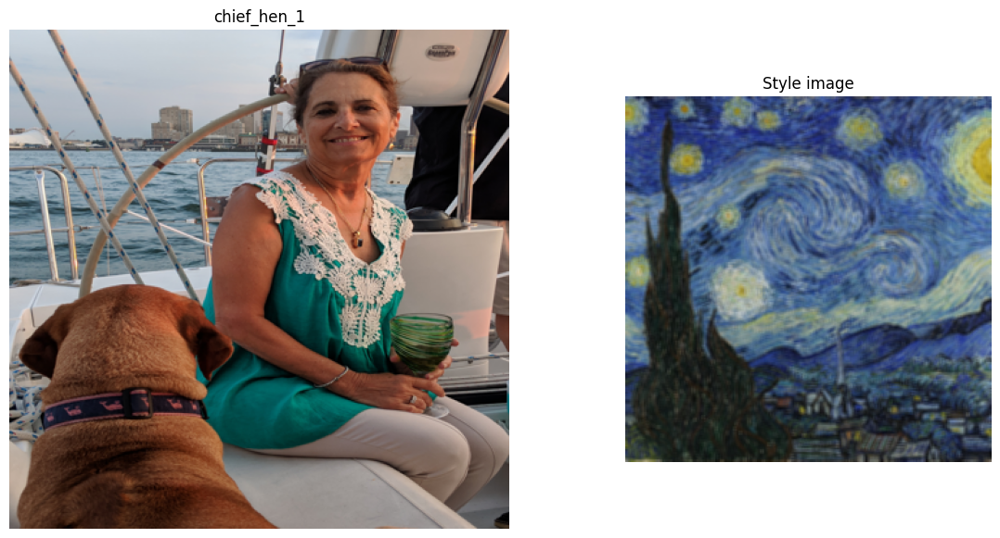

In [188]:

show_n([mom_jazzy, style_image], ['chief_hen_1', 'Style image'])

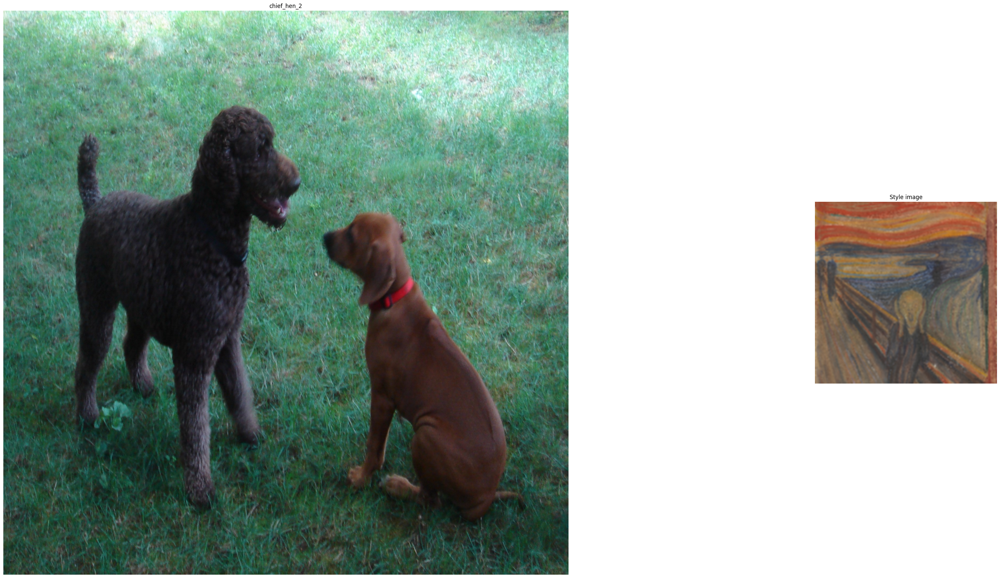

In [244]:

show_n([ch2, style_image], ['chief_hen_2', 'Style image'])

In [85]:
from tensorflow import float32


In [47]:
style_urls = dict(
  kanagawa_great_wave='https://upload.wikimedia.org/wikipedia/commons/0/0a/The_Great_Wave_off_Kanagawa.jpg',
  kandinsky_composition_7='https://upload.wikimedia.org/wikipedia/commons/b/b4/Vassily_Kandinsky%2C_1913_-_Composition_7.jpg',
  hubble_pillars_of_creation='https://upload.wikimedia.org/wikipedia/commons/6/68/Pillars_of_creation_2014_HST_WFC3-UVIS_full-res_denoised.jpg',
  van_gogh_starry_night='https://upload.wikimedia.org/wikipedia/commons/thumb/e/ea/Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg',
  turner_nantes='https://upload.wikimedia.org/wikipedia/commons/b/b7/JMW_Turner_-_Nantes_from_the_Ile_Feydeau.jpg',
  munch_scream='https://upload.wikimedia.org/wikipedia/commons/c/c5/Edvard_Munch%2C_1893%2C_The_Scream%2C_oil%2C_tempera_and_pastel_on_cardboard%2C_91_x_73_cm%2C_National_Gallery_of_Norway.jpg',
  picasso_demoiselles_avignon='https://upload.wikimedia.org/wikipedia/en/4/4c/Les_Demoiselles_d%27Avignon.jpg',
  picasso_violin='https://upload.wikimedia.org/wikipedia/en/3/3c/Pablo_Picasso%2C_1911-12%2C_Violon_%28Violin%29%2C_oil_on_canvas%2C_Kr%C3%B6ller-M%C3%BCller_Museum%2C_Otterlo%2C_Netherlands.jpg',
  picasso_bottle_of_rum='https://upload.wikimedia.org/wikipedia/en/7/7f/Pablo_Picasso%2C_1911%2C_Still_Life_with_a_Bottle_of_Rum%2C_oil_on_canvas%2C_61.3_x_50.5_cm%2C_Metropolitan_Museum_of_Art%2C_New_York.jpg',
  fire='https://upload.wikimedia.org/wikipedia/commons/3/36/Large_bonfire.jpg',
  derkovits_woman_head='https://upload.wikimedia.org/wikipedia/commons/0/0d/Derkovits_Gyula_Woman_head_1922.jpg',
  amadeo_style_life='https://upload.wikimedia.org/wikipedia/commons/8/8e/Untitled_%28Still_life%29_%281913%29_-_Amadeo_Souza-Cardoso_%281887-1918%29_%2817385824283%29.jpg',
  derkovtis_talig='https://upload.wikimedia.org/wikipedia/commons/3/37/Derkovits_Gyula_Talig%C3%A1s_1920.jpg',
  amadeo_cardoso='https://upload.wikimedia.org/wikipedia/commons/7/7d/Amadeo_de_Souza-Cardoso%2C_1915_-_Landscape_with_black_figure.jpg'
)

In [48]:
style_image_size = 256
#content_images = {k: load_image(v, (content_image_size, content_image_size)) for k, v in content_urls.items()}
style_images = {k: load_image(v, (style_image_size, style_image_size)) for k, v in style_urls.items()}
style_images = {k: tf.nn.avg_pool(style_image, ksize=[3,3], strides=[1,1], padding='SAME') for k, style_image in style_images.items()}

66306/66306 [==============================] - 0s 1us/step


In [88]:
style_images.keys()

dict_keys(['kanagawa_great_wave', 'kandinsky_composition_7', 'hubble_pillars_of_creation', 'van_gogh_starry_night', 'turner_nantes', 'munch_scream', 'picasso_demoiselles_avignon', 'picasso_violin', 'picasso_bottle_of_rum', 'fire', 'derkovits_woman_head', 'amadeo_style_life', 'derkovtis_talig', 'amadeo_cardoso'])

In [275]:
style_image = style_images['munch_scream']


outputs = hub_module(tf.cast(burke_funny, dtype=float32), tf.constant(style_image))
stylized_image = outputs[0]

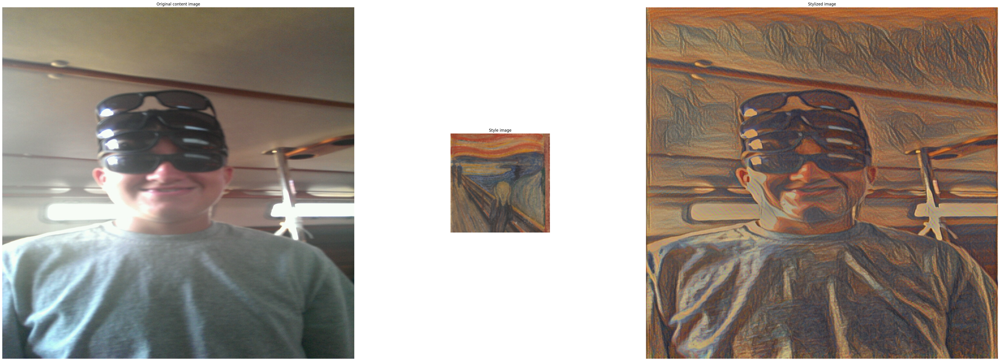

In [276]:
# Visualize input images and the generated stylized image.

show_n([burke_funny, style_image, stylized_image], titles=['Original content image', 'Style image', 'Stylized image'])

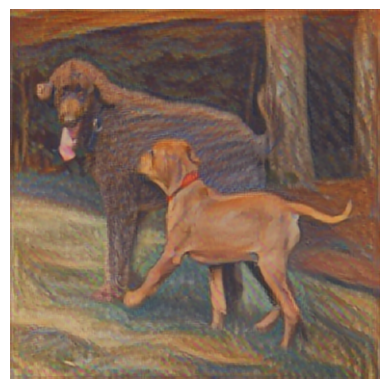

In [177]:
plt.imshow(stylized_image[0], aspect='equal')
plt.axis('off')
plt.show()

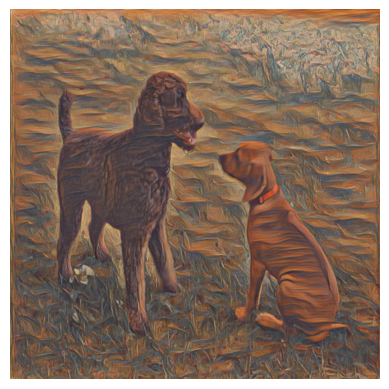

In [251]:
plt.imshow(stylized_image[0], aspect='equal')
plt.axis('off')
plt.show()

In [253]:
ch2_im = tf.keras.utils.array_to_img(stylized_image[0])

In [254]:
ch2_im.size

(1452, 1452)

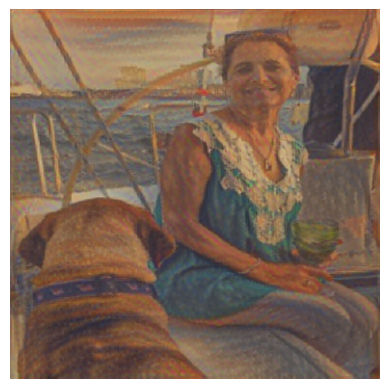

In [219]:
plt.imshow(stylized_image[0], aspect='equal')
plt.axis('off')
plt.show()

In [222]:
ch2_output = stylized_image[0]

In [224]:
ch2_output = tf.keras.utils.array_to_img(ch2_output)

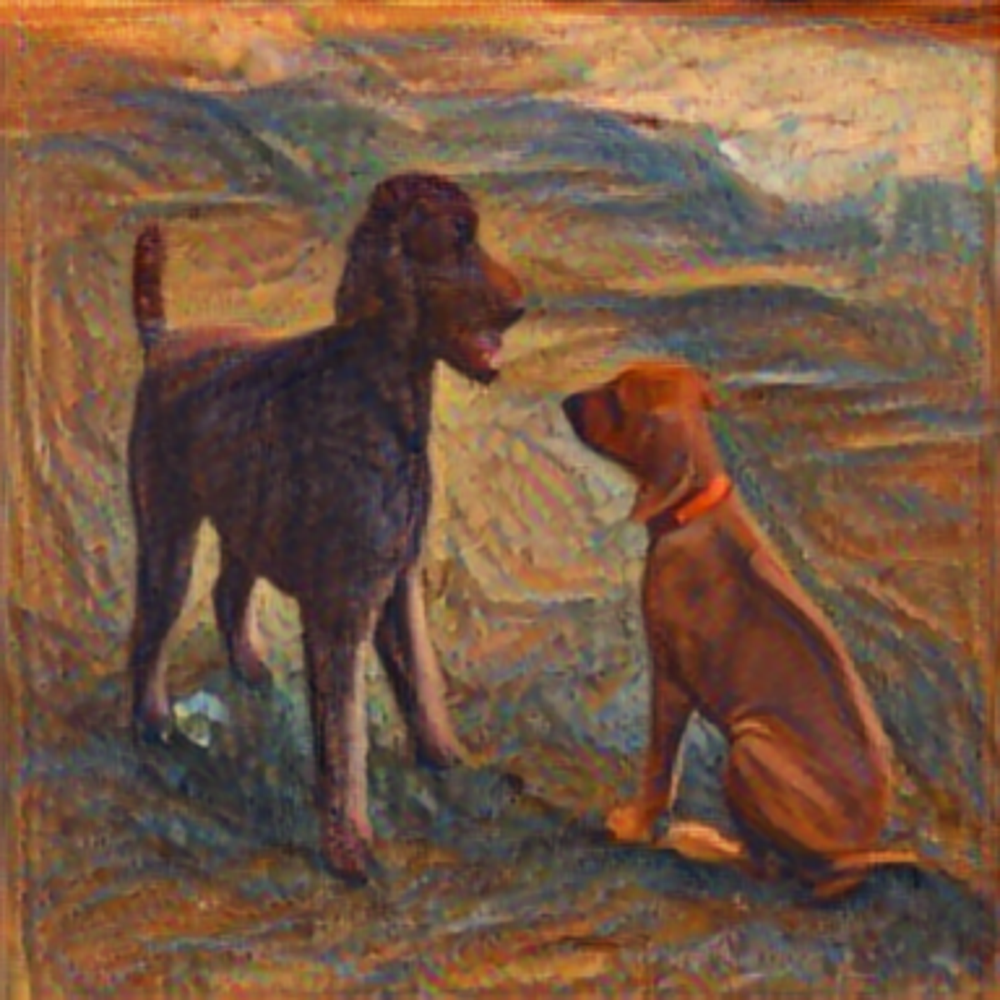

In [227]:
ch2_output.resize((1200,1200))

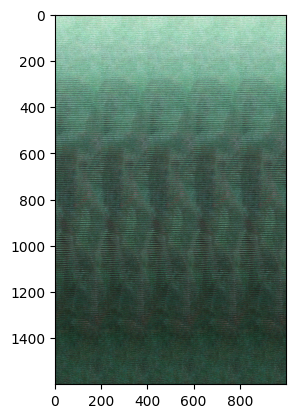

In [238]:
plt.imshow(ch2.reshape(1600,1000,3))